<a href="https://colab.research.google.com/github/Manguriu/daata101/blob/main/Redone%20data%20for%20KWANZA%20TUKULE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Kwanza Tukule Data Analyst Assessment


Thank you for your interest in joining Kwanza Tukule. This assessment is designed to evaluate your technical, analytical, and problem-solving skills. The dataset provided represents anonymized sales data. Use it to complete the tasks below and demonstrate your ability to derive actionable insights and recommendations.

Please submit your work as a Jupyter Notebook, R script, Excel workbook, or a detailed PDF report.


Section 1: Data Cleaning and Preparation (20 points)

Data Quality Assessment: Inspect the dataset for missing values, duplicates, or inconsistent data types. Provide a summary of issues identified and the steps taken to resolve them.
Feature Engineering: Create the following columns: “Month-Year” (e.g., August 2024) from the “DATE” column. (include a screenshot of this in your submission)

Section 2: Exploratory Data Analysis (30 points)

Sales Overview:
Calculate total Quantity and Value grouped by:
Anonymized Category
Anonymized Business
Provide visualizations (e.g., bar charts or tables) to support your findings.

Trends Over Time: Analyze sales trends (Value and Quantity) by Month-Year. Create a time series plot to show seasonal patterns or changes in sales performance.
Performance Analysis:
Identify the top 5 most frequently purchased products (based on Quantity).
Identify the top 5 most valuable products (based on Value).


Section 3: Advanced Analysis (30 points)

Customer Segmentation:
Perform a segmentation analysis of businesses (Anonymized Business) based on their purchasing behavior:
Total Quantity purchased
Total Value contributed
Frequency of transactions
Classify businesses into 3 groups (e.g., High Value, Medium Value, Low Value) and provide recommendations for engagement with each group.
Forecasting: Using the provided data, forecast the total sales (Value) for the next 3 months. Use an appropriate time-series forecasting method (e.g., ARIMA, moving average, or exponential smoothing).
Anomaly Detection:Identify any unusual spikes or drops in sales performance (Quantity or Value) and explain possible reasons based on the data.
Correlation Analysis:Examine relationships between Quantity and Value. Provide insights into which factors drive sales performance.

Section 4: Strategic Insights and Recommendations (20 points)

Product Strategy: Based on your analysis, recommend one product category to prioritize for marketing campaigns. Justify your choice using the data.
Customer Retention: Identify businesses that have reduced their purchase frequency over time. Suggest strategies to re-engage these customers.
Operational Efficiency:Suggest improvements to inventory management or supply chain processes based on trends in product performance and seasonal demand.

Section 5: Dashboard and Reporting (20 points)

Create a dashboard summarizing key insights, including:
Total Quantity and Value by Anonymized Category.
Top-performing products and businesses.
A time-series chart of sales trends.
A segmentation summary of customer groups.
Use tools such as Power BI, Tableau, or a Python library (e.g., Plotly, Dash) to make the dashboard interactive (if possible). Provide a screenshot or link to the dashboard.


Bonus Section: Open-Ended Problem (Optional, 10 points)

Predictive Analysis: Identify external factors that could influence sales (e.g., economic conditions, competitor actions). Propose a methodology to incorporate such factors into future analyses.
Scalability: If the dataset were 10 times larger, what optimizations would you implement for data storage, processing, and analysis?

Instructions and Guidelines

Data is available on a google sheet here -> https://docs.google.com/spreadsheets/d/1E90iFRs0fbn3cldZCQo7cGZ8XmBDYpdHuqeUEC3TGXc/edit?gid=1416790554#gid=1416790554
Tools: You may use Python, R, SQL, Excel, or any other tool of your choice.
Submission: Include all code, visualizations, and explanations. Document your thought process clearly.
Time: You have 2 weeks to complete this assessment.


Evaluation Criteria

Data Cleaning and Preparation (20%)
Exploratory and Advanced Analysis (30%)
Insights and Recommendations (30%)
Dashboard and Reporting (20%)


##Section 1

In [ ]:
import pandas as pd
sheet_url = "/content/Case Study Data - Read Only - case_study_data_2025-01-16T06_49_12.19881Z (1).csv"
data = pd.read_csv(sheet_url)


print(data.info())
print(data.describe())
print(data.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 333405 entries, 0 to 333404
Data columns (total 7 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   DATE                 333405 non-null  object
 1   ANONYMIZED CATEGORY  333405 non-null  object
 2   ANONYMIZED PRODUCT   333405 non-null  object
 3   ANONYMIZED BUSINESS  333405 non-null  object
 4   ANONYMIZED LOCATION  333405 non-null  object
 5   QUANTITY             333405 non-null  int64 
 6   UNIT PRICE           333397 non-null  object
dtypes: int64(1), object(6)
memory usage: 17.8+ MB
None
            QUANTITY
count  333405.000000
mean        2.321186
std         3.790614
min         0.000000
25%         1.000000
50%         1.000000
75%         2.000000
max       359.000000
                       DATE ANONYMIZED CATEGORY ANONYMIZED PRODUCT  \
0  August 18, 2024, 9:32 PM        Category-106       Product-21f4   
1  August 18, 2024, 9:32 PM        Category-120       P

In [ ]:
#Data Quality Assesments

missing_values = data.isnull().sum()
print("Here are the missing values", missing_values)

Here are the missing values DATE                   0
ANONYMIZED CATEGORY    0
ANONYMIZED PRODUCT     0
ANONYMIZED BUSINESS    0
ANONYMIZED LOCATION    0
QUANTITY               0
UNIT PRICE             8
dtype: int64


In [ ]:
# Filter rows where 'UNIT PRICE' is missing
missing_unit_price_rows = data[data['UNIT PRICE'].isnull()]

# Print the rows
print("Rows with missing UNIT PRICE values:")
print(missing_unit_price_rows)


Rows with missing UNIT PRICE values:
                              DATE ANONYMIZED CATEGORY ANONYMIZED PRODUCT  \
108112       July 3, 2024, 5:53 PM         Category-94       Product-3d7f   
150961  December 16, 2024, 6:33 PM         Category-79       Product-dfc8   
151142  December 22, 2024, 2:42 PM        Category-122       Product-15e0   
272379     June 27, 2024, 12:15 PM         Category-92       Product-ccbc   
278284    August 14, 2024, 9:09 PM        Category-101       Product-84a5   
278384  December 30, 2024, 2:17 PM         Category-95       Product-15f3   
310385     March 31, 2024, 2:03 PM        Category-114       Product-9204   
327152    August 13, 2024, 4:20 PM        Category-107       Product-7eed   

       ANONYMIZED BUSINESS ANONYMIZED LOCATION  QUANTITY UNIT PRICE  
108112       Business-4fce       Location-f37d         2        NaN  
150961       Business-8bbf       Location-3fc0         1        NaN  
151142       Business-c575       Location-1979         3   

In [ ]:
# Drop rows where 'UNIT PRICE' is missing
data = data.dropna(subset=['UNIT PRICE'])

# Verify that there are no missing values in 'UNIT PRICE'
print("Remaining missing values in UNIT PRICE:", data['UNIT PRICE'].isnull().sum())


Remaining missing values in UNIT PRICE: 0


In [ ]:
#Checking for duplicates
duplicates = data.duplicated().sum()
print(f"There are :{duplicates} duplicates")

There are :0 duplicates


In [ ]:
#Lets remove the data duplicate and save it
# Extract duplicate rows
duplicate_rows = data[data.duplicated()]

# Save duplicate rows to a CSV file
duplicate_file_path = '/content/duplicate_rows.csv'
duplicate_rows.to_csv(duplicate_file_path, index=False)

print("Duplicate rows saved to:", duplicate_file_path)


Duplicate rows saved to: /content/duplicate_rows.csv


In [ ]:
#for better data quality lets drop the duplicate data
data = data.drop_duplicates()

# Verify removal
print(f"Remaining duplicate rows: {data.duplicated().sum()}")


Remaining duplicate rows: 0


In [ ]:
#lets save the cleaned data now
cleaned_file_path = '/content/cleaned_data.csv'
data.to_csv(cleaned_file_path, index=False)

print("Cleaned data saved to:", cleaned_file_path)


Cleaned data saved to: /content/cleaned_data.csv


In [ ]:
#Now lets work with the cleaned data
import pandas as pd
sheet_url = "/content/cleaned_data.csv"
NewData = pd.read_csv(sheet_url)


print(NewData.info())
print(NewData.describe())
print(NewData.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 329881 entries, 0 to 329880
Data columns (total 7 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   DATE                 329881 non-null  object
 1   ANONYMIZED CATEGORY  329881 non-null  object
 2   ANONYMIZED PRODUCT   329881 non-null  object
 3   ANONYMIZED BUSINESS  329881 non-null  object
 4   ANONYMIZED LOCATION  329881 non-null  object
 5   QUANTITY             329881 non-null  int64 
 6   UNIT PRICE           329873 non-null  object
dtypes: int64(1), object(6)
memory usage: 17.6+ MB
None
            QUANTITY
count  329881.000000
mean        2.321507
std         3.767796
min         0.000000
25%         1.000000
50%         1.000000
75%         2.000000
max       359.000000
                       DATE ANONYMIZED CATEGORY ANONYMIZED PRODUCT  \
0  August 18, 2024, 9:32 PM        Category-106       Product-21f4   
1  August 18, 2024, 9:32 PM        Category-120       P

In [ ]:
#lets cobvert data types for better performance
NewData['DATE'] = pd.to_datetime(NewData['DATE'])  # Ensure DATE is datetime type
NewData['QUANTITY'] = NewData['QUANTITY'].astype('int32')
NewData['UNIT PRICE'] = NewData['UNIT PRICE'].replace(',', '', regex=True).astype('float32')


<ipython-input-9-3b004c464a5b>:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  NewData['DATE'] = pd.to_datetime(NewData['DATE'])  # Ensure DATE is datetime type


In [ ]:
#3. Feature Engineering
# Create a Month-Year column:
NewData["Month-Year"]= NewData["DATE"].dt.strftime("%B %Y")

#Display dataset with the new column
print(NewData[["DATE","Month-Year"]].head())



                 DATE   Month-Year
0 2024-08-18 21:32:00  August 2024
1 2024-08-18 21:32:00  August 2024
2 2024-08-18 21:32:00  August 2024
3 2024-08-18 21:32:00  August 2024
4 2024-08-18 21:32:00  August 2024


In [ ]:
#checking the whole data with the new added columns
print(NewData.head())

                 DATE ANONYMIZED CATEGORY ANONYMIZED PRODUCT  \
0 2024-08-18 21:32:00        Category-106       Product-21f4   
1 2024-08-18 21:32:00        Category-120       Product-4156   
2 2024-08-18 21:32:00        Category-121       Product-49bd   
3 2024-08-18 21:32:00         Category-76       Product-61dd   
4 2024-08-18 21:32:00        Category-119       Product-66e0   

  ANONYMIZED BUSINESS ANONYMIZED LOCATION  QUANTITY  UNIT PRICE   Month-Year  
0       Business-de42       Location-1ba8         1       850.0  August 2024  
1       Business-de42       Location-1ba8         2      1910.0  August 2024  
2       Business-de42       Location-1ba8         1      3670.0  August 2024  
3       Business-de42       Location-1ba8         1      2605.0  August 2024  
4       Business-de42       Location-1ba8         5      1480.0  August 2024  


In [ ]:
#lets save the new data with new columns
cleaned_file_path = '/content/cleaned_data_with_columns.csv'
NewData.to_csv(cleaned_file_path, index=False)

print("Cleaned new_data saved to:", cleaned_file_path)



Cleaned new_data saved to: /content/cleaned_data_with_columns.csv


##Step 2: Exploratory Data Analysis

In [ ]:
#Looking at the sales overview
# Lets group Anonymized Category and Anonymized Business:

category_sales = NewData.groupby('ANONYMIZED CATEGORY').agg({'QUANTITY': 'sum', 'UNIT PRICE': 'sum'}).reset_index()
business_sales = NewData.groupby('ANONYMIZED BUSINESS').agg({'QUANTITY': 'sum', 'UNIT PRICE': 'sum'}).reset_index()

print(category_sales.head(12))
print(business_sales.head(12))


   ANONYMIZED CATEGORY  QUANTITY  UNIT PRICE
0         Category-100     76824  30783426.0
1         Category-101     19585  12225757.0
2         Category-102      1786    270769.0
3         Category-104      1217   1278629.0
4         Category-105      1579   2121947.0
5         Category-106      6521   4566978.0
6         Category-107      2730   3226218.0
7         Category-108      9756   3038145.0
8         Category-109      1446    806716.0
9         Category-110     10529   4215429.0
10        Category-111      6715   3385923.0
11        Category-113       741    732152.0
   ANONYMIZED BUSINESS  QUANTITY  UNIT PRICE
0        Business-0000         8     10445.0
1        Business-0005         1      2645.0
2        Business-0029        26     18385.0
3        Business-003d        98     73251.0
4        Business-0072       127    194501.0
5        Business-0078       317    882264.0
6        Business-007a         2      4010.0
7        Business-0086         6     11200.0
8        B

In [ ]:
category_sales = category_sales.nlargest(10, 'QUANTITY')

fig = px.bar(
    category_sales,
    x='ANONYMIZED CATEGORY',
    y=['QUANTITY'],
    title='Sales by Category(quantity)'
    )
fig2 = px.bar(
    category_sales,
    x='ANONYMIZED CATEGORY',
    y='UNIT PRICE',
    title='Sales by Category(price)'
)
fig.show()
fig2.show()


In [ ]:
top_businesses = business_sales.nlargest(10, 'QUANTITY')
fig = px.bar(
    top_businesses,
    x='ANONYMIZED BUSINESS',
    y='QUANTITY',
    title='Quantity by Business'
)

fig2 = px.bar(
    top_businesses,
    x='ANONYMIZED BUSINESS',
    y='UNIT PRICE',
    title='Unit Price by Business'
)

fig.show()
fig2.show()


In [ ]:
#2. Trends Over Time grouped by month-year
monthly_trends = NewData.groupby('Month-Year').agg({'QUANTITY': 'sum', 'UNIT PRICE': 'sum'}).reset_index()
print(monthly_trends.head(12))


        Month-Year  QUANTITY  UNIT PRICE
0       April 2024     50554  48452360.0
1      August 2024     68859  64574376.0
2    December 2024     57631  53702904.0
3    February 2024     44063  53537044.0
4     January 2024     67526  70511152.0
5        July 2024     74691  73511536.0
6        June 2024     60717  59761092.0
7       March 2024     45382  49988736.0
8         May 2024     69551  69627696.0
9    November 2024     75361  73430632.0
10    October 2024     84739  82152976.0
11  September 2024     66747  65730448.0


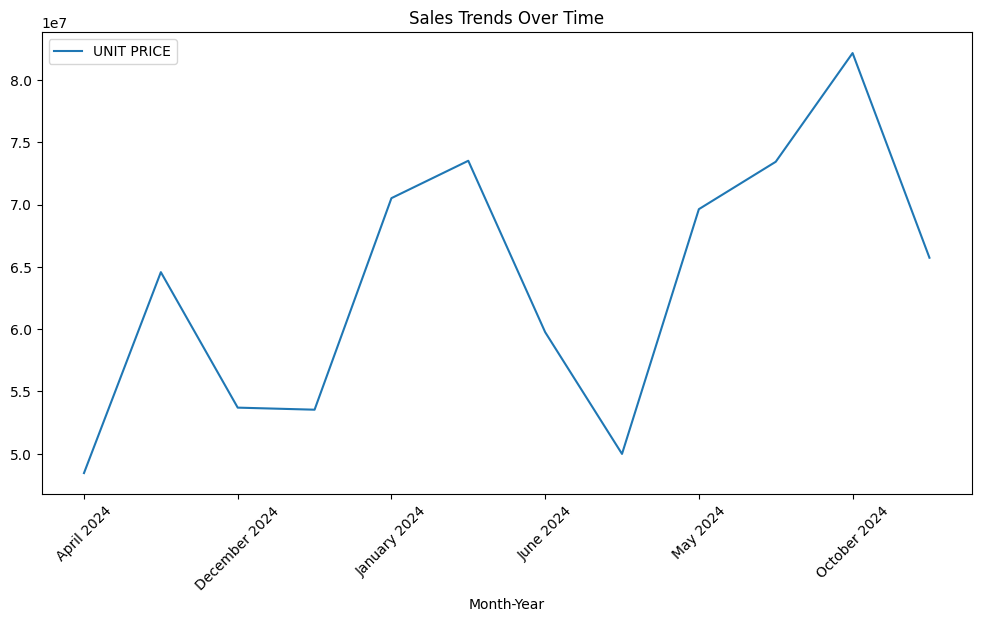

In [ ]:
# A time series plot on the same
monthly_trends.plot(x='Month-Year', y='UNIT PRICE', kind='line', title='Sales Trends Over Time', figsize=(12, 6))
plt.xticks(rotation=45)
plt.show()


In [ ]:
# performance analysis of the top 5 products
top_products_quantity = NewData.groupby('ANONYMIZED PRODUCT')['QUANTITY'].sum().nlargest(5)
top_products_value = NewData.groupby('ANONYMIZED PRODUCT')['UNIT PRICE'].sum().nlargest(5)

print("Top 5 Products by QUANTITY:\n", top_products_quantity)
print("Top 5 Products by UNITPRICE:\n", top_products_value)


Top 5 Products by QUANTITY:
 ANONYMIZED PRODUCT
Product-66e0    46957
Product-e805    42602
Product-8f75    37566
Product-29ee    35940
Product-4156    28487
Name: QUANTITY, dtype: int32
Top 5 Products by UNITPRICE:
 ANONYMIZED PRODUCT
Product-e805    151785312.0
Product-8f75     63007632.0
Product-66e0     27880230.0
Product-2175     24141324.0
Product-d09c     24020716.0
Name: UNIT PRICE, dtype: float32


In [ ]:
top_products = top_products_quantity.reset_index()

print(top_products.columns)

fig = px.bar(
    top_products,
    x='ANONYMIZED PRODUCT',
    y='QUANTITY',
    title='Top 5 Products by Quantity'
)

fig.show()


Index(['ANONYMIZED PRODUCT', 'QUANTITY'], dtype='object')


In [ ]:
top_products_v = top_products_value.reset_index()

print(top_products_v.columns)

fig = px.bar(
    top_products_v,
    x='ANONYMIZED PRODUCT',
    y='UNIT PRICE',
    title='Top 5 Products by value'
)

fig.show()

Index(['ANONYMIZED PRODUCT', 'UNIT PRICE'], dtype='object')


In [ ]:
from IPython.display import display

# Display summary tables
print("5 most frequently purchased products:")
display(top_products_quantity)

print("5 most valuable products (based on Value):")
display(top_products_value)


5 most frequently purchased products:


,QUANTITY
ANONYMIZED PRODUCT,
Product-66e0,46957
Product-e805,42602
Product-8f75,37566
Product-29ee,35940
Product-4156,28487


5 most valuable products (based on Value):


,UNIT PRICE
ANONYMIZED PRODUCT,
Product-e805,151785312.0
Product-8f75,63007632.0
Product-66e0,27880230.0
Product-2175,24141324.0
Product-d09c,24020716.0


##Step 3: Advanced Analysis






In [ ]:
#Customer Segmentation
#Creating a summary metrics for each business:
business_summary = NewData.groupby('ANONYMIZED BUSINESS').agg(
    total_quantity=('QUANTITY', 'sum'),
    total_value=('UNIT PRICE', 'sum'),
    transaction_count=('DATE', 'count')
).reset_index()

print(business_summary.head(10))


  ANONYMIZED BUSINESS  total_quantity  total_value  transaction_count
0       Business-0000               8      10445.0                  8
1       Business-0005               1       2645.0                  1
2       Business-0029              26      18385.0                  6
3       Business-003d              98      73251.0                 31
4       Business-0072             127     194501.0                101
5       Business-0078             317     882264.0                254
6       Business-007a               2       4010.0                  2
7       Business-0086               6      11200.0                  6
8       Business-00a2               9      17645.0                  7
9       Business-00a7               5       1885.0                  1


In [ ]:
#classifying businesses into segments
business_summary['Segment'] = pd.cut(
    business_summary['total_value'],
    bins=[0, 10000, 50000, float('inf')],
    labels=['Low Value', 'Medium Value', 'High Value']
)
print(business_summary['Segment'].value_counts())


Segment
High Value      1845
Low Value       1606
Medium Value    1348
Name: count, dtype: int64


In [ ]:
import plotly.express as px

fig = px.pie(
    business_summary,
    names='Segment',
    values='total_value',
    title='Segment-wise Contribution to Sales'
)
fig.show()


In [ ]:
# #Forecasting Using Exponential Smoothing:
# # Simple moving average
# monthly_trends['Rolling_Mean'] = monthly_trends['UNIT PRICE'].rolling(window=3).mean()

# # Forecast the next 3 months using the last rolling mean
# last_mean_value = monthly_trends['Rolling_Mean'].iloc[-1]
# forecast = [last_mean_value] * 3
# print("Next 3 months sales forecast using moving average:", forecast)


Next 3 months sales forecast using moving average: [73771352.0, 73771352.0, 73771352.0]


In [ ]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Since there are 12 months of data
monthly_trends['Value'] = monthly_trends['QUANTITY'] * monthly_trends['UNIT PRICE']

model = ExponentialSmoothing(monthly_trends['Value'], trend='add').fit()

forecast = model.forecast(steps=3)

print("Next 3 months forecast:\n", forecast)


Next 3 months forecast:
 12    5.300402e+12
13    5.487907e+12
14    5.675411e+12
dtype: float64


/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning:

Optimization failed to converge. Check mle_retvals.



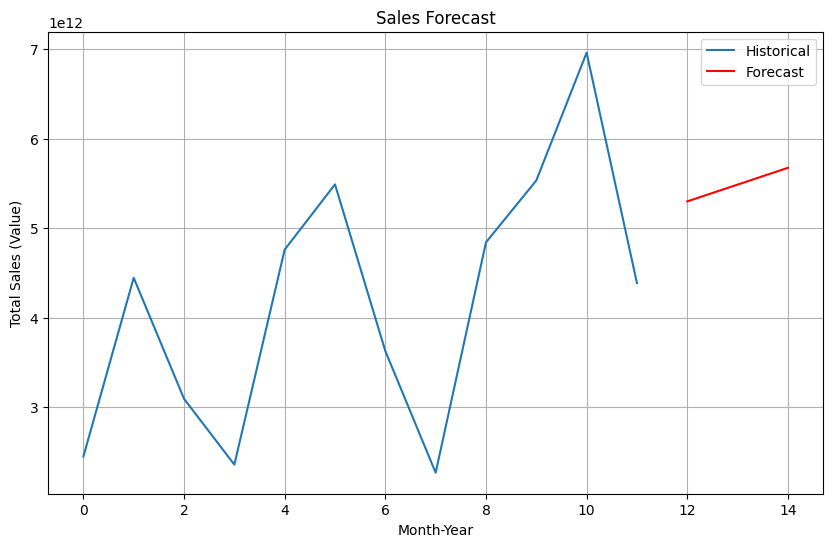

In [ ]:
import matplotlib.pyplot as plt

monthly_trends['Value'] = monthly_trends['QUANTITY'] * monthly_trends['UNIT PRICE']

# Plot historical data
monthly_trends['Value'].plot(label='Historical', figsize=(10, 6))

# Plot forecast data
forecast.plot(label='Forecast', color='red')

# Add labels and legend
plt.title('Sales Forecast')
plt.xlabel('Month-Year')
plt.ylabel('Total Sales (Value)')
plt.legend()
plt.grid(True)
plt.show()


In [ ]:
#Anomaly Detection  Detect spikes or drops using standard deviation:
NewData['Value'] = NewData['QUANTITY'] * NewData['UNIT PRICE']

NewData['Value_Change'] = NewData['Value'].diff()
anomalies = NewData[NewData['Value_Change'].abs() > NewData['Value_Change'].std()]

print("Anomalies detected:\n", anomalies)


Anomalies detected:
                       DATE ANONYMIZED CATEGORY ANONYMIZED PRODUCT  \
27     2024-05-23 20:22:00        Category-113       Product-9c60   
29     2024-09-27 21:33:00         Category-94       Product-77bc   
38     2024-09-12 09:00:00         Category-75       Product-8b75   
39     2024-11-03 15:58:00         Category-98       Product-bd79   
40     2024-11-03 15:58:00        Category-120       Product-d53e   
...                    ...                 ...                ...   
329767 2024-02-11 19:45:00         Category-78       Product-1d3d   
329771 2024-11-10 13:01:00         Category-75       Product-4fca   
329772 2024-03-29 22:45:00         Category-75       Product-4832   
329819 2024-05-03 15:35:00        Category-120       Product-29ee   
329843 2024-10-24 21:26:00         Category-76       Product-61dd   

       ANONYMIZED BUSINESS ANONYMIZED LOCATION  QUANTITY  UNIT PRICE  \
27           Business-22a2       Location-c2f2         5      5870.0   
29    

In [ ]:
monthly_data = NewData.groupby('Month-Year')['Value'].sum().reset_index()
monthly_data['Value_Change'] = monthly_data['Value'].diff()
anomalies = monthly_data[monthly_data['Value_Change'].abs() > monthly_data['Value_Change'].std()]

print("Monthly anomalies detected:\n", anomalies)


Monthly anomalies detected:
         Month-Year        Value  Value_Change
2    December 2024  109549774.0   -37031229.0
4     January 2024  185626186.0    59046484.0
6        June 2024  135138614.0   -35902267.0
8         May 2024  168781502.0    52780826.0
11  September 2024  137791455.0   -46049096.0


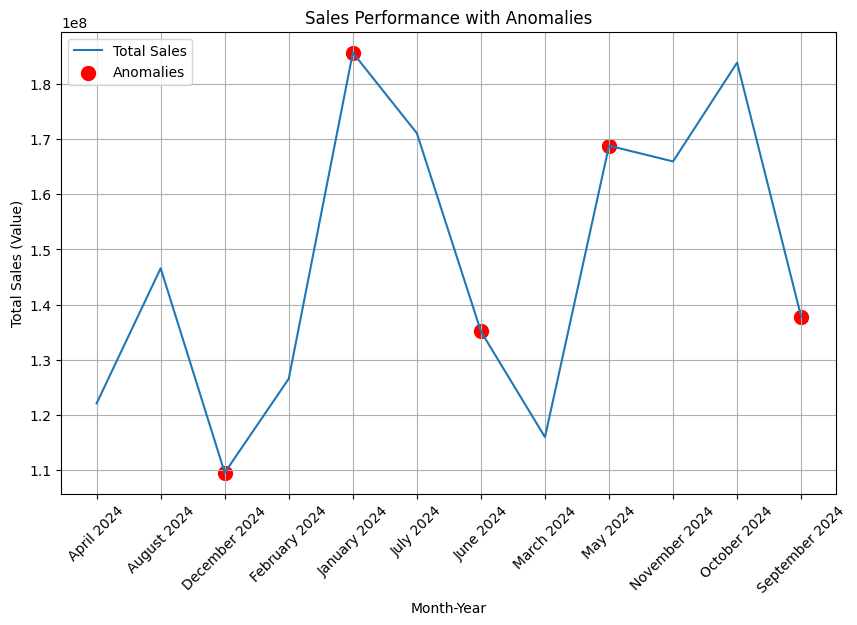

In [ ]:
import matplotlib.pyplot as plt

# Plot the time series with anomalies
plt.figure(figsize=(10, 6))
plt.plot(monthly_data['Month-Year'], monthly_data['Value'], label='Total Sales')
plt.scatter(anomalies['Month-Year'], anomalies['Value'], color='red', label='Anomalies', s=100)

plt.title('Sales Performance with Anomalies')
plt.xlabel('Month-Year')
plt.ylabel('Total Sales (Value)')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.show()


In [ ]:
#Correlation Analysis to Calculate correlation between Quantity and Value:
NewData['Value'] = NewData['QUANTITY'] * NewData['UNIT PRICE']

correlation = NewData[['QUANTITY', 'Value']].corr()
print("Correlation between QUANTITY and UNIT PRICE:\n", correlation)


Correlation between QUANTITY and UNIT PRICE:
           QUANTITY     Value
QUANTITY  1.000000  0.835333
Value     0.835333  1.000000


In [ ]:
import plotly.express as px

# Scatter plot of Quantity vs. Value
fig = px.scatter(NewData, x='QUANTITY', y='Value', title='Quantity vs. Value', trendline='ols')
fig.show()


In [ ]:
# Scatter plot of Quantity vs. Unit Price
fig = px.scatter(NewData, x='QUANTITY', y='UNIT PRICE', title='Quantity vs. Unit Price', trendline='ols')
fig.show()


In [106]:
fig = px.scatter(NewData, x='QUANTITY', y='Value', color='ANONYMIZED CATEGORY', title='Quantity vs. Value by Category')
fig.show()


In [ ]:
import plotly.express as px

# Aggregated sales by category
category_sales = NewData.groupby('ANONYMIZED CATEGORY')[['QUANTITY', 'Value']].sum().reset_index()

# Plot sales performance by category
fig = px.bar(category_sales, x='ANONYMIZED CATEGORY', y='Value', title='Sales Performance by Category')
fig.show()


##Step 4: Strategic Insights and Recommendations

In [108]:
#Based on top products and sales performance, recommend a category to prioritize.
#(combines total sales value and quantity sold)
NewData['Value'] = NewData['QUANTITY'] * NewData['UNIT PRICE']
category_sales['Performance_Score'] = (category_sales['Value'] * 0.7) + (category_sales['QUANTITY'] * 0.3)
prioritized_category = category_sales.sort_values(by='Performance_Score', ascending=False).iloc[0]
print("Recommended category based on performance score:", prioritized_category)


Recommended category based on performance score: ANONYMIZED CATEGORY    Category-75
QUANTITY                    151330
Value                  544658700.0
Performance_Score      381306489.0
Name: 25, dtype: object


In [109]:
import plotly.express as px

fig = px.bar(category_sales, x='ANONYMIZED CATEGORY', y='Performance_Score', title='Category Performance Comparison')
fig.show()


In [112]:
# Group by Business and Time Period Month-Year'
monthly_frequency = NewData.groupby(['ANONYMIZED BUSINESS', 'Month-Year'])['DATE'].count().reset_index(name='transaction_count')

# Calculating frequency change over time for each business
monthly_frequency['freq_change'] = monthly_frequency.groupby('ANONYMIZED BUSINESS')['transaction_count'].diff()

# Identifying businesses with consistently negative or declining frequency
declining_frequency = monthly_frequency[monthly_frequency['freq_change'] < 0].groupby('ANONYMIZED BUSINESS').size().reset_index(name='declining_periods')

# Sort to find businesses with the most decline periods
declining_businesses = declining_frequency.sort_values(by='declining_periods', ascending=False)
print("Businesses with declining purchase frequency:\n", declining_businesses.head(20))



Businesses with declining purchase frequency:
      ANONYMIZED BUSINESS  declining_periods
1015       Business-5feb                  8
196        Business-14dd                  8
1770       Business-a8da                  8
1940       Business-b882                  8
1035       Business-60fb                  8
584        Business-37ee                  8
1796       Business-aaef                  8
2335       Business-e12e                  8
2037       Business-c206                  8
1036       Business-610c                  7
2172       Business-cf4b                  7
280        Business-1c6c                  7
1975       Business-bbc0                  7
1771       Business-a8db                  7
396        Business-260e                  7
241        Business-18f1                  7
531        Business-3280                  7
1321       Business-7a60                  7
1431       Business-838f                  7
516        Business-3112                  7


In [114]:
import plotly.express as px


fig = px.bar(
    declining_businesses,
    x='ANONYMIZED BUSINESS',
    y='declining_periods',
    title='Businesses with Declining Purchase Frequency',
    labels={'declining_periods': 'Declining Periods', 'ANONYMIZED BUSINESS': 'Business'},
    text='declining_periods'
)

fig.update_traces(textposition='outside')
fig.update_layout(
    xaxis_tickangle=-45,
    height=600,
    width=900
)

fig.show()


In [117]:
top_products = NewData.groupby('ANONYMIZED PRODUCT')[['Value', 'QUANTITY']].sum().sort_values(by='Value', ascending=False)
top_product = top_products.head(1)
print("Top Product:\n", top_product)

Top Product:
                           Value  QUANTITY
ANONYMIZED PRODUCT                       
Product-e805        262787281.0     42602


In [118]:
seasonal_trends = NewData.groupby(['ANONYMIZED PRODUCT', 'Month-Year'])['QUANTITY'].sum().reset_index()
seasonal_trends  = seasonal_trends .head(1)
print("Top Trends:\n", seasonal_trends )

Top Trends:
   ANONYMIZED PRODUCT     Month-Year  QUANTITY
0       Product-0001  December 2024       286


<ipython-input-122-9b2e76b58e56>:11: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency MS will be used.

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/holtwinters/model.py:918: ConvergenceWarning:

Optimization failed to converge. Check mle_retvals.



Next 3 months demand forecast:
 2025-01-01    85620.123486
2025-02-01    88618.090542
2025-03-01    91616.057598
Freq: MS, dtype: float64


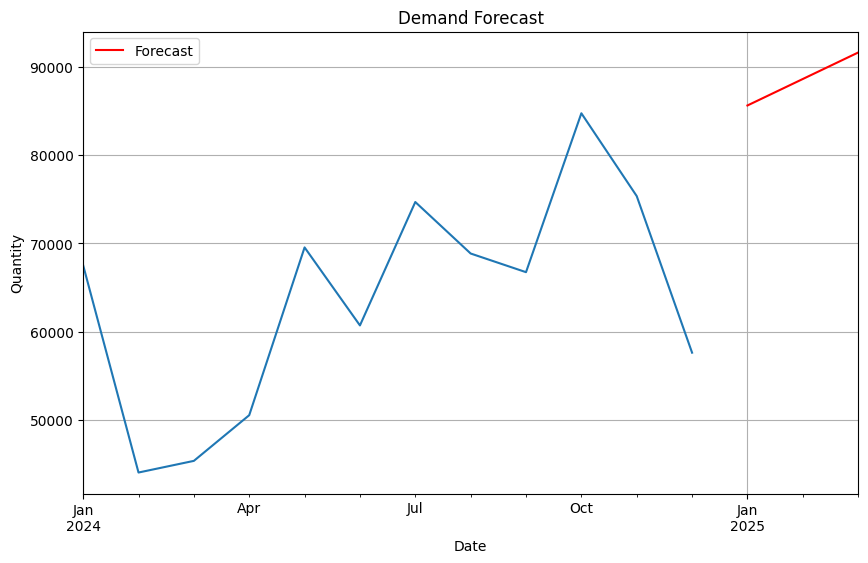

In [122]:
import pandas as pd
from statsmodels.tsa.holtwinters import ExponentialSmoothing
import plotly.express as px

# Ensuring that NewData has the 'Month-Year' and 'QUANTITY' columns
seasonal_trends = NewData.groupby('Month-Year')['QUANTITY'].sum().reset_index()

# 2. Check if there are enough data points for time-series forecasting
if len(seasonal_trends) > 1:
# Ensuring the 'Month-Year' column is set as the index
    seasonal_trends['Month-Year'] = pd.to_datetime(seasonal_trends['Month-Year'])
    seasonal_trends = seasonal_trends.sort_values('Month-Year')
    seasonal_trends.set_index('Month-Year', inplace=True)

#Fitting the Exponential Smoothing model
    model = ExponentialSmoothing(seasonal_trends['QUANTITY'], trend='add').fit()

#Forecasting the next 3 months
    forecast = model.forecast(steps=3)
    print("Next 3 months demand forecast:\n", forecast)

#Ploting the historical data and forecast
    seasonal_trends['QUANTITY'].plot(label='Historical Data', figsize=(10, 6))
    forecast.plot(label='Forecast', color='red', legend=True)
    plt.title('Demand Forecast')
    plt.xlabel('Date')
    plt.ylabel('Quantity')
    plt.grid(True)
    plt.show()

else:
    print("Not enough data points for time-series forecasting.")


##Section 5: Dashboard and Reporting

In [123]:
import plotly.express as px

NewData['Value'] = NewData['QUANTITY'] * NewData['UNIT PRICE']

# Sales by Category
fig = px.bar(category_sales, x='ANONYMIZED CATEGORY', y=['QUANTITY', 'Value'], title='Sales by Category')
fig.show()

# Top Products
product_sales = NewData.groupby('ANONYMIZED PRODUCT').agg({'Value': 'sum', 'QUANTITY': 'sum'}).reset_index()
top_products = product_sales.sort_values(by='Value', ascending=False).head(10)
fig = px.bar(top_products, x='ANONYMIZED PRODUCT', y='Value', title='Top Products by Sales Value')
fig.show()

# Top Businesses
top_businesses = business_summary.sort_values(by='total_value', ascending=False).head(10)
fig = px.bar(top_businesses, x='ANONYMIZED BUSINESS', y='total_value', title='Top Businesses by Sales Value')
fig.show()


# Time-series sales trends
fig = px.line(monthly_trends, x='Month-Year', y='Value', title='Monthly Sales Trends')
fig.show()

# Customer Segmentation Summary
fig = px.pie(business_summary, names='Segment', values='total_value', title='Customer Segmentation')
fig.show()





In [126]:
!pip install dash

import dash
from dash import dcc, html
import plotly.express as px

# Ensure necessary data frames are available (NewData, category_sales, business_summary, monthly_trends)

# Step 1: Calculate Value if not already done
NewData['Value'] = NewData['QUANTITY'] * NewData['UNIT PRICE']

# Step 2: Generate figures
# Sales by Category
fig_category_sales = px.bar(category_sales, x='ANONYMIZED CATEGORY', y=['QUANTITY', 'Value'], title='Sales by Category')

# Top Products by Sales Value
product_sales = NewData.groupby('ANONYMIZED PRODUCT').agg({'Value': 'sum', 'QUANTITY': 'sum'}).reset_index()
top_products = product_sales.sort_values(by='Value', ascending=False).head(10)
fig_top_products = px.bar(top_products, x='ANONYMIZED PRODUCT', y='Value', title='Top Products by Sales Value')

# Top Businesses by Sales Value
top_businesses = business_summary.sort_values(by='total_value', ascending=False).head(10)
fig_top_businesses = px.bar(top_businesses, x='ANONYMIZED BUSINESS', y='total_value', title='Top Businesses by Sales Value')

# Time-Series Sales Trends
fig_sales_trends = px.line(monthly_trends, x='Month-Year', y='Value', title='Monthly Sales Trends')

# Customer Segmentation Summary
fig_segmentation = px.pie(business_summary, names='Segment', values='total_value', title='Customer Segmentation')

# Step 3: Set up the Dash app layout
app = dash.Dash(__name__)

app.layout = html.Div([
    html.H1("Sales Dashboard"),

    # Sales by Category
    html.H2("Sales by Category"),
    dcc.Graph(figure=fig_category_sales),

    # Top Products
    html.H2("Top Products by Sales Value"),
    dcc.Graph(figure=fig_top_products),

    # Top Businesses
    html.H2("Top Businesses by Sales Value"),
    dcc.Graph(figure=fig_top_businesses),

    # Time-Series Trends
    html.H2("Monthly Sales Trends"),
    dcc.Graph(figure=fig_sales_trends),

    # Customer Segmentation
    html.H2("Customer Segmentation"),
    dcc.Graph(figure=fig_segmentation)
])

# Step 4: Run the server
if __name__ == '__main__':
    app.run_server(debug=True)


<IPython.core.display.Javascript object>